## Trigger Word Detection

Goal: Constructing a speech dataset and implementing an algorithm for trigger word detection (sometimes also called keyword detection, or wake word detection). 
- Synthesize and process audio recordings to create train/dev datasets
- Train a trigger word detection model and make predictions

In this code: the trigger word will be "activate" --> Every time it hears you say "activate", it will make a "chiming" sound. 

## steps followed by code:

- 1- Data synthesis: Creating a Speech Dataset
    - Listening to the Data
    - From Audio Recordings to Spectrograms
    - Generating a Single Training Example
        - is_overlapping
        - insert_audio_clip
        - insert_ones
        - create_training_example
    - Full Training Set
    - Development Set
- 2- The Model
    - Build the Model --> modelf
    - Fit the Model
    - Test the Model
- 3- Making Predictions --> Testing on Dev Examples


In [1]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
from td_utils import *
%matplotlib inline

### 1 - Data synthesis: Creating a Speech Dataset :
#### Listening to the Data (some examples):   

 This dataset includes people speaking in a variety of accents. In the raw_data directory, there are three types of recordings (positives/negatives/backgrounds) to create a labeled dataset. These audio files will be used to synthesize a dataset to train the model. 
   
   * The "activate" directory contains positive examples of people saying the word "activate". 
   * The "negatives" directory contains negative examples of people saying random words other than "activate". 
   * There is one word per audio recording. 
   * The "backgrounds" directory contains 10 second clips of background noise in different environments.

In [2]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/activates/1.wav")

In [3]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/negatives/4.wav")

In [4]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/backgrounds/1.wav")

#### From Audio Recordings to Spectrograms:
The spectrogram will tell how much different frequencies are present in an audio clip at any moment in time. 

In [5]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/example_train.wav")

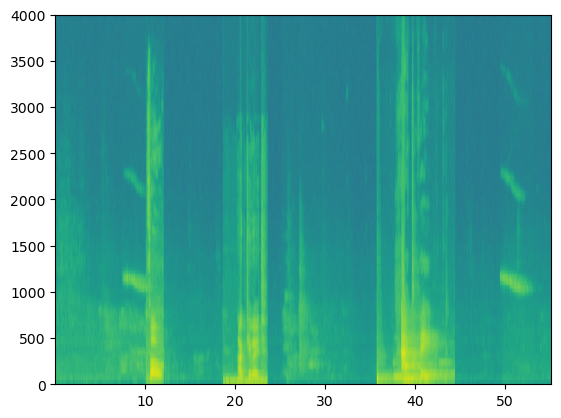

In [6]:
x = graph_spectrogram("E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/example_train.wav")

* The color in the spectrogram shows the degree to which different frequencies are present (loud) in the audio at different points in time. 
* Green means a certain frequency is more active or more present in the audio clip (louder).
* Blue squares denote less active frequencies.
* The dimension of the output spectrogram depends upon the hyperparameters of the spectrogram software and the length of the input. 

* In this code,  worked with 10 second audio clips as the "standard length" for our training examples. 
    * The number of timesteps of the spectrogram will be 5511. 
    * The spectrogram will be the input $x$ into the network, and so $T_x = 5511$.

In [7]:
_, data = wavfile.read("E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/example_train.wav")
print("Time steps in audio recording before spectrogram", data[:,0].shape)
print("Time steps in input after spectrogram", x.shape)

Time steps in audio recording before spectrogram (441000,)
Time steps in input after spectrogram (101, 5511)


In [8]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram

* A spectrogram divides 10 seconds into 5,511 units.
    * $T_x = 5511$
* The output of our model will divide 10 seconds into 1,375 units.
    * $T_y = 1375$
    * For each of the 1375 time steps, the model predicts whether someone recently finished saying the trigger word "activate".

In [9]:
Ty = 1375 # The number of time steps in the output of our model

#### Generating a Single Training Example:

In [10]:
# Load audio segments using pydub 
activates, negatives, backgrounds = load_raw_audio('E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/')

print("background len should be 10,000, since it is a 10 sec clip\n" + str(len(backgrounds[0])),"\n")
print("activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) \n" + str(len(activates[0])),"\n")
print("activate[1] len: different `activate` clips can have different lengths\n" + str(len(activates[1])),"\n")

background len should be 10,000, since it is a 10 sec clip
10000 

activate[0] len may be around 1000, since an `activate` audio clip is usually around 1 second (but varies a lot) 
721 

activate[1] len: different `activate` clips can have different lengths
731 



#### Overlaying positive/negative 'word' audio clips on top of the background audio

* To insert multiple clips of positive/negative words into the background --> Not to insert an "activate" or a random word somewhere that overlaps with another clip you had previously added. 
    * To ensure that the 'word' audio segments do not overlap when inserted --> keeping track of the times of previously inserted audio clips.  
    * The resulting audio clip is still 10 seconds long.
    
#### Label the positive/negative words

    - y<t> = 1 when that clip has finished saying "activate".
    - Given a background clip, we can initialize y<t> = 0 for all t, since the clip doesn't contain any "activate". 
    - Rather than updating the label of a single time step --> Updating 50 steps of the output to have target label 1. 
    
    - Training a GRU (Gated Recurrent Unit) to detect when someone has **finished** saying "activate". 
    
    
#### Visualizing the labels
* A figure illustrating the labels y<t> in a clip:
    * inserted "activate", "innocent", "activate", "baby." 
    * the positive labels "1" --> are associated only with the positive words. 
    
    
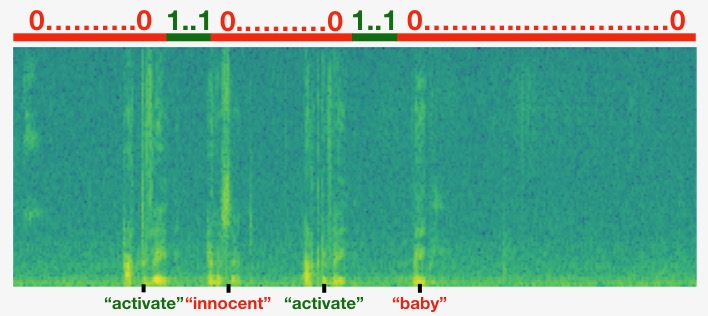

#### Get a random time segment:

In [11]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.
    
    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

#### is_overlapping:
There is overlap if:
* The new segment starts before the previous segment ends **and**
* The new segment ends after the previous segment starts.

In [12]:
def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.
    
    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments
    
    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """
    
    segment_start, segment_end = segment_time
    
    # Step 1: Initializing overlap as a "False" flag.
    overlap = False
    
    # Step 2: loop over the previous_segments start and end times.
    # Comparing start/end times and setting the flag to True if there is an overlap 
    for previous_start, previous_end in previous_segments: # @KEEP
        if segment_start <= previous_end and segment_end >= previous_start :
            overlap = True
            break

    return overlap

In [13]:
# UNIT TEST
def is_overlapping_test(target):
    assert target((670, 1430), []) == False, "Overlap with an empty list must be False"
    assert target((500, 1000), [(100, 499), (1001, 1100)]) == False, "Almost overlap, but still False"
    assert target((750, 1250), [(100, 750), (1001, 1100)]) == True, "Must overlap with the end of first segment"
    assert target((750, 1250), [(300, 600), (1250, 1500)]) == True, "Must overlap with the begining of second segment"
    assert target((750, 1250), [(300, 600), (600, 1500), (1600, 1800)]) == True, "Is contained in second segment"
    assert target((800, 1100), [(300, 600), (900, 1000), (1600, 1800)]) == True, "New segment contains the second segment"

    print("\033[92m All tests passed!")
    
is_overlapping_test(is_overlapping)

 All tests passed!


In [14]:
overlap1 = is_overlapping((950, 1430), [(2000, 2550), (260, 949)])
overlap2 = is_overlapping((2305, 2950), [(824, 1532), (1900, 2305), (3424, 3656)])
print("Overlap 1 = ", overlap1)
print("Overlap 2 = ", overlap2)

Overlap 1 =  False
Overlap 2 =  True


#### insert_audio_clip:
Implementing 4 steps:

1. Get the length of the audio clip that is to be inserted.
    * Get a random time segment whose duration equals the duration of the audio clip that is to be inserted.
2. Make sure that the time segment does not overlap with any of the previous time segments. 
    * If it is overlapping, then go back to step 1 and pick a new time segment.
3. Append the new time segment to the list of existing time segments
    * This keeps track of all the segments that are inserted.  
4. Overlay the audio clip over the background using pydub. 

In [15]:
def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the 
    audio segment does not overlap with existing segments.
    
    Arguments:
    background -- a 10 second background audio recording.  
    audio_clip -- the audio clip to be inserted/overlaid. 
    previous_segments -- times where audio segments have already been placed
    
    Returns:
    new_background -- the updated background audio
    """
    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
    
    # Step 1: to pick a random time segment onto which to insert the new audio clip. 
    segment_time = get_random_time_segment(segment_ms)
    
    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. To avoid an endless loop
    retry = 5 # @KEEP 
    while is_overlapping(segment_time, previous_segments) and retry >= 0:
        segment_time = get_random_time_segment(segment_ms)
        retry = retry - 1
    
        
    # if last try is not overlaping, inserting it to the background
    if not is_overlapping(segment_time, previous_segments):
    
        # Step 3: Append the new segment_time to the list of previous_segments 
        previous_segments.append(segment_time)
    
        # Step 4: Superpose audio segment and background
        new_background = background.overlay(audio_clip, position = segment_time[0])
    else:
        
        new_background = background
        segment_time = (10000, 10000)
    
    return new_background, segment_time

In [17]:
np.random.seed(5)
audio_clip, segment_time = insert_audio_clip(backgrounds[0], activates[0], [(3790, 4400)])
audio_clip.export("insert_test.wav", format="wav")
print("Segment Time: ", segment_time)
IPython.display.Audio("insert_test.wav")

Segment Time:  (2915, 3635)


In [18]:
# Expected audio
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/insert_reference.wav")

#### insert_ones:

In [20]:
def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment 
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 following labels should be ones.
    
    
    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms
    
    Returns:
    y -- updated labels
    """
    _, Ty = y.shape
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    if segment_end_y < Ty:
        # Adding 1 to the correct index in the background label (y)
        for i in range(segment_end_y+1, segment_end_y+51):
            if i < Ty:
                y[0, i] = 1
    
    return y

In [21]:
import random
def insert_ones_test(target):
    segment_end_y = random.randrange(0, Ty - 50) 
    segment_end_ms = int(segment_end_y * 10000.4) / Ty;    
    arr1 = target(np.zeros((1, Ty)), segment_end_ms)

    assert type(arr1) == np.ndarray, "Wrong type. Output must be a numpy array"
    assert arr1.shape == (1, Ty), "Wrong shape. It must match the input shape"
    assert np.sum(arr1) == 50, "It must insert exactly 50 ones"
    assert arr1[0][segment_end_y - 1] == 0, f"Array at {segment_end_y - 1} must be 0"
    assert arr1[0][segment_end_y] == 0, f"Array at {segment_end_y} must be 0"
    assert arr1[0][segment_end_y + 1] == 1, f"Array at {segment_end_y + 1} must be 1"
    assert arr1[0][segment_end_y + 50] == 1, f"Array at {segment_end_y + 50} must be 1"
    assert arr1[0][segment_end_y + 51] == 0, f"Array at {segment_end_y + 51} must be 0"

    print("\033[92m All tests passed!")
    
insert_ones_test(insert_ones)

 All tests passed!


sanity checks: 0.0 1.0 0.0


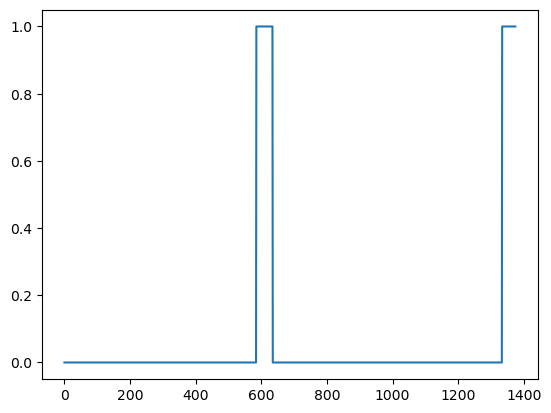

In [22]:
arr1 = insert_ones(np.zeros((1, Ty)), 9700)
plt.plot(insert_ones(arr1, 4251)[0,:])
print("sanity checks:", arr1[0][1333], arr1[0][634], arr1[0][635])

#### create_training_example:
1. Initialize the label vector $y$ as a numpy array of zeros and shape $(1, T_y)$.
2. Initialize the set of existing segments to an empty list.
3. Randomly select 0 to 4 "activate" audio clips, and insert them onto the 10 second clip. Also insert labels at the correct position in the label vector $y$.
4. Randomly select 0 to 2 negative audio clips, and insert them into the 10 second clip. 

In [23]:
def create_training_example(background, activates, negatives, Ty):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    Ty -- The number of time steps in the output

    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Make background quieter
    background = background - 20

    # Step 1: Initialize y (label vector) of zeros 
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list 
    previous_segments = []
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    number_of_activates = np.random.randint(0, 5)
    random_indices = np.random.randint(len(activates), size=number_of_activates)
    random_activates = [activates[i] for i in random_indices]
    
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for one_random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, one_random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y" at segment_end
        y = insert_ones(y, segment_end)

    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    number_of_negatives = np.random.randint(0, 3)
    random_indices = np.random.randint(len(negatives), size=number_of_negatives)
    random_negatives = [negatives[i] for i in random_indices]

    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives: # @KEEP
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)

    # Export new training example 
    file_handle = background.export("train" + ".wav", format="wav")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("train.wav")
    
    return x, y

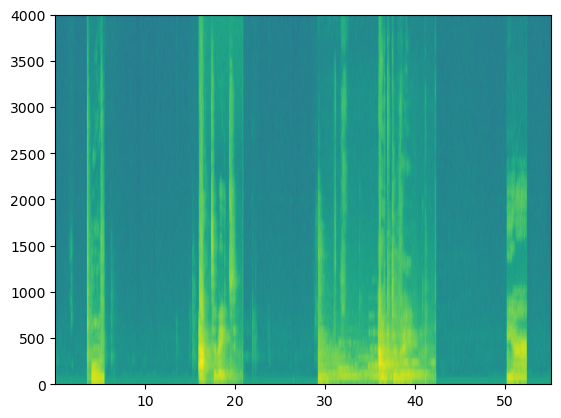

In [25]:
# Set the random seed
np.random.seed(18)
x, y = create_training_example(backgrounds[0], activates, negatives, Ty)

Listening to the training example that was created and compare it to the spectrogram generated above.

In [26]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/train.wav")

In [27]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/train_reference.wav")

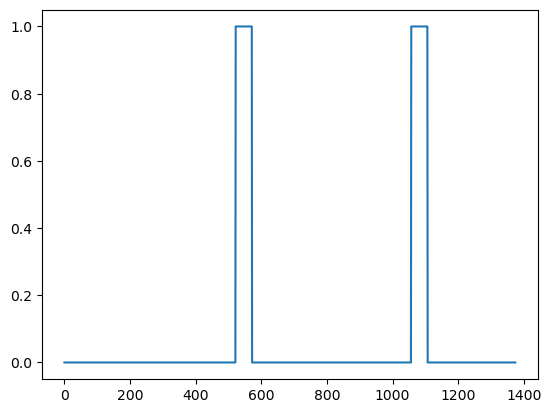

In [28]:
plt.plot(y[0])

#### Full Training Set:
Generating a smaller training set of 32 examples. 

0
10
20
30


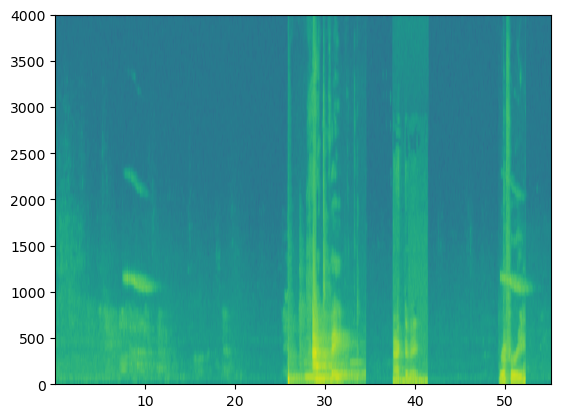

In [29]:
np.random.seed(4543)
nsamples = 32
X = []
Y = []
for i in range(0, nsamples):
    if i%10 == 0:
        print(i)
    x, y = create_training_example(backgrounds[i % 2], activates, negatives, Ty)
    X.append(x.swapaxes(0,1))
    Y.append(y.swapaxes(0,1))
X = np.array(X)
Y = np.array(Y)

#### Development Set:

* To test the model, a development set of 25 examples was recorded. 
* While the training data is synthesized, a development set will be created using the same distribution as the real inputs. 
* Thus, 25 10-second audio clips of people saying "activate" and other random words will be recorded, and labeled them by hand. 

In [31]:
# Load preprocessed dev set examples
X_dev = np.load("E:/new CV/DL/DL_projects/trigger_word_detection/XY_dev/X_dev.npy")
Y_dev = np.load("E:/new CV/DL/DL_projects/trigger_word_detection/XY_dev/Y_dev.npy")

### 2 - The Model:
The model will use 1-D convolutional layers, GRU layers, and dense layers. 

In [33]:
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from tensorflow.keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from tensorflow.keras.optimizers import Adam

#### Build the Model:
This network will use 4 layers:
-  A convolutional layer
-  Two GRU layers
-  A dense layer.


##### 1D convolutional layer:
One key layer of this model is the 1D convolutional step. 
* It inputs the 5511 step spectrogram.  Each step is a vector of 101 units.
* It outputs a 1375 step output
* This output is further processed by multiple layers to get the final $T_y = 1375$ step output. 

##### GRU, dense and sigmoid:
* The two GRU layers read the sequence of inputs from left to right.
* A dense plus sigmoid layer makes a prediction for $y^{\langle t \rangle}$. 
* Because $y$ is a binary value (0 or 1) -->  using a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate".

#### Unidirectional RNN

Implementing the model can be done in four steps:

**Step 1**: CONV layer. Using Conv1D() to implement this, with 196 filters, 
a filter size of 15 (kernel_size=15), and stride of 4. [conv1d](https://keras.io/layers/convolutional/#conv1d)

**Step 2**: First GRU layer. To generate the GRU layer, use 128 units.

**Step 3**: Second GRU layer. This has the same specifications as the first GRU layer.

**Step 4**: Create a time-distributed dense layer.


In [34]:
def modelf(input_shape):
    """
    Function creating the model's graph in Keras.
    
    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """
    
    X_input = Input(shape = input_shape)
    
    
    # Step 1: CONV layer 
    # Add a Conv1D with 196 units, kernel size of 15 and stride of 4
    X = Conv1D(filters=196, kernel_size=15, strides=4)(X_input)
    X = BatchNormalization()(X)
    X = Activation('relu')(X)
    X = Dropout(rate=0.8)(X)                                  

    # Step 2: First GRU Layer 
    # GRU (use 128 units and return the sequences)
    X = GRU(128, return_sequences=True)(X)
    X = Dropout(rate=0.8)(X)
    X = BatchNormalization()(X)                           
    
    # Step 3: Second GRU Layer
    # GRU (use 128 units and return the sequences)
    X = GRU(128, return_sequences=True)(X)
    X = Dropout(rate=0.8)(X)       
    X = BatchNormalization()(X)
    X = Dropout(rate=0.8)(X)                                 
    
    # Step 4: Time-distributed dense layer 
    # TimeDistributed  with sigmoid activation 
    X = TimeDistributed(Dense(1, activation='sigmoid'))(X) 

  

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [36]:
from test_utils_word import *

def modelf_test(target):
    Tx = 5511
    n_freq = 101
    model = target(input_shape = (Tx, n_freq))
    expected_model = [['InputLayer', [(None, 5511, 101)], 0],
                     ['Conv1D', (None, 1375, 196), 297136, 'valid', 'linear', (4,), (15,), 'GlorotUniform'],
                     ['BatchNormalization', (None, 1375, 196), 784],
                     ['Activation', (None, 1375, 196), 0],
                     ['Dropout', (None, 1375, 196), 0, 0.8],
                     ['GRU', (None, 1375, 128), 125184, True],
                     ['Dropout', (None, 1375, 128), 0, 0.8],
                     ['BatchNormalization', (None, 1375, 128), 512],
                     ['GRU', (None, 1375, 128), 99072, True],
                     ['Dropout', (None, 1375, 128), 0, 0.8],
                     ['BatchNormalization', (None, 1375, 128), 512],
                     ['Dropout', (None, 1375, 128), 0, 0.8],
                     ['TimeDistributed', (None, 1375, 1), 129, 'sigmoid']]
    comparator(summary(model), expected_model)
    
    
modelf_test(modelf)

All tests passed!


In [37]:
model = modelf(input_shape = (Tx, n_freq))

In [38]:
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 5511, 101)]       0         
                                                                 
 conv1d_2 (Conv1D)           (None, 1375, 196)         297136    
                                                                 
 batch_normalization_6 (Bat  (None, 1375, 196)         784       
 chNormalization)                                                
                                                                 
 activation_2 (Activation)   (None, 1375, 196)         0         
                                                                 
 dropout_8 (Dropout)         (None, 1375, 196)         0         
                                                                 
 gru_4 (GRU)                 (None, 1375, 128)         125184    
                                                           

#### Fit the Model:

In [39]:
from tensorflow.keras.models import model_from_json

json_file = open('E:/new CV/DL/DL_projects/trigger_word_detection/models/model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
model.load_weights('E:/new CV/DL/DL_projects/trigger_word_detection/models/model.h5')

#### Block Training for BatchNormalization Layers:

In [43]:
model.layers[2].trainable = False
model.layers[7].trainable = False
model.layers[10].trainable = False

In [44]:
#opt = Adam(lr=1e-6, beta_1=0.9, beta_2=0.999)
#model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])
opt = Adam(learning_rate=1e-6, beta_1=0.9, beta_2=0.999)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

In [45]:
model.fit(X, Y, batch_size = 16, epochs=1)

2/2 [==============================] - 5s 1s/step - loss: 0.5787 - accuracy: 0.7233


#### Test the Model:

In [46]:
loss, acc, = model.evaluate(X_dev, Y_dev)
print("Dev set accuracy = ", acc)

1/1 [==============================] - 1s 1s/step - loss: 0.5109 - accuracy: 0.7971
Dev set accuracy =  0.7971199750900269


### Making Predictions:

In [47]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)
    
    # Correct the amplitude of the input file before prediction 
    audio_clip = AudioSegment.from_wav(filename)
    audio_clip = match_target_amplitude(audio_clip, -20.0)
    file_handle = audio_clip.export("tmp.wav", format="wav")
    filename = "tmp.wav"

    x = graph_spectrogram(filename)
    # the spectrogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

In [50]:
chime_file = "E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    i = 0
    # Step 2: Loop over the output steps in the y
    while i < Ty:
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold for 20 consecutive output steps have passed
        if consecutive_timesteps > 20:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds) * 1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
            i = 75 * (i // 75 + 1)
            continue
        # if amplitude is smaller than the threshold reset the consecutive_timesteps counter
        if predictions[0, i, 0] < threshold:
            consecutive_timesteps = 0
        i += 1
        
    audio_clip.export("chime_output.wav", format='wav')

### Test on Dev Examples:
Letting first listen to the two dev set clips.

In [51]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/dev/1.wav")

In [52]:
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/dev/2.wav")

1/1 [==============================] - 0s 142ms/step


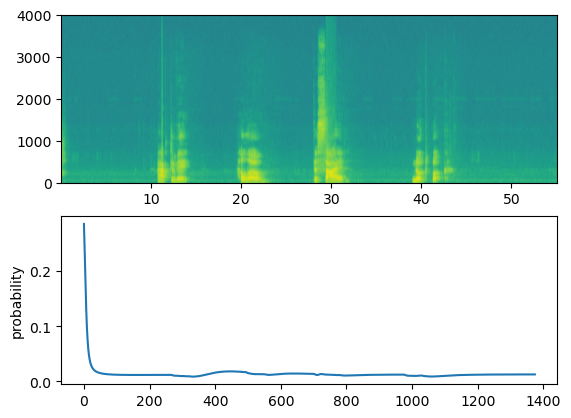

In [53]:
filename = "E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/dev/1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

1/1 [==============================] - 0s 157ms/step


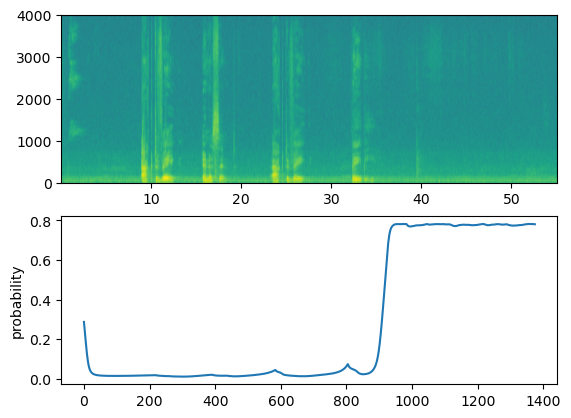

In [54]:
filename  = "E:/new CV/DL/DL_projects/trigger_word_detection/raw_data/dev/2.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/chime_output.wav")

### Try Your Own Example:

In [55]:
def preprocess_audio(filename):
    # Trim or pad audio segment to 10000ms
    padding = AudioSegment.silent(duration=10000)
    segment = AudioSegment.from_wav(filename)[:10000]
    segment = padding.overlay(segment)
    # Set frame rate to 44100
    segment = segment.set_frame_rate(44100)
    # Export as wav
    segment.export(filename, format='wav')

In [56]:
your_filename = "E:/new CV/DL/DL_projects/trigger_word_detection/audio_examples/my_audio.wav"

In [57]:
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) 

1/1 [==============================] - 0s 111ms/step


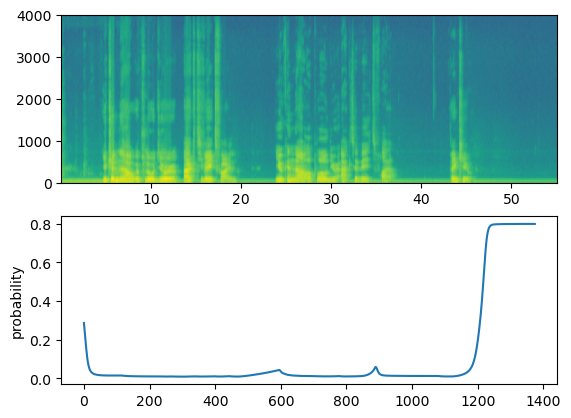

In [58]:
chime_threshold = 0.5
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("E:/new CV/DL/DL_projects/trigger_word_detection/chime_output.wav")